In [1]:
%pylab inline
import numpy as np
import scipy.io as io

Populating the interactive namespace from numpy and matplotlib


In [2]:
ImPoints = io.loadmat("data/compEx1data.mat")["x"]

Im1Pts = ImPoints[0, 0].T
Im2Pts = ImPoints[1, 0].T

Im1 = imread("data/kronan1.JPG")
Im2 = imread("data/kronan2.JPG")

(<matplotlib.figure.Figure at 0xbfbde48>,
 <matplotlib.axes._subplots.AxesSubplot at 0xc1447f0>)

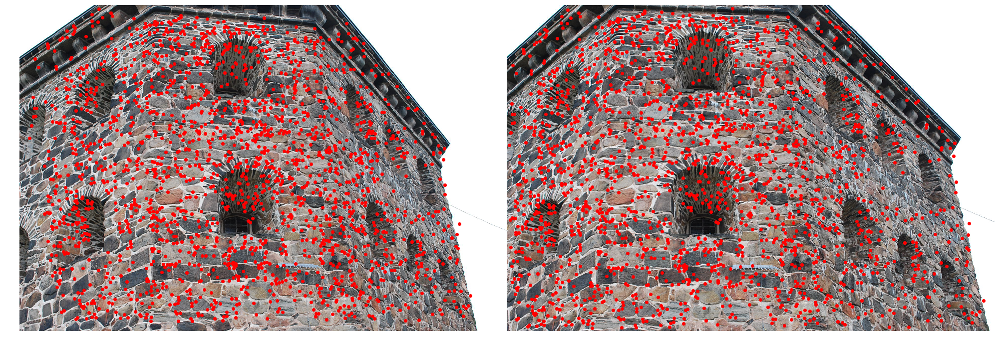

In [3]:
def DrawPoints(Im1, Im2, Pts1, Pts2):
    Im1_2 = np.hstack((Im1, Im2))
    fig = figure(figsize=(35, 20))
    ax = fig.add_subplot(1, 1, 1)
    ax.axis('off')
    ax.imshow(Im1_2)
    ax.scatter(Pts1[:, 0], Pts1[:, 1], c='r')
    ax.scatter(Pts2[:, 0] + Im1.shape[1], Pts2[:, 1], c='r')
    return fig, ax

DrawPoints(Im1, Im2, Im1Pts, Im2Pts)

x'^T @ F @ x =  0.6664272051885511


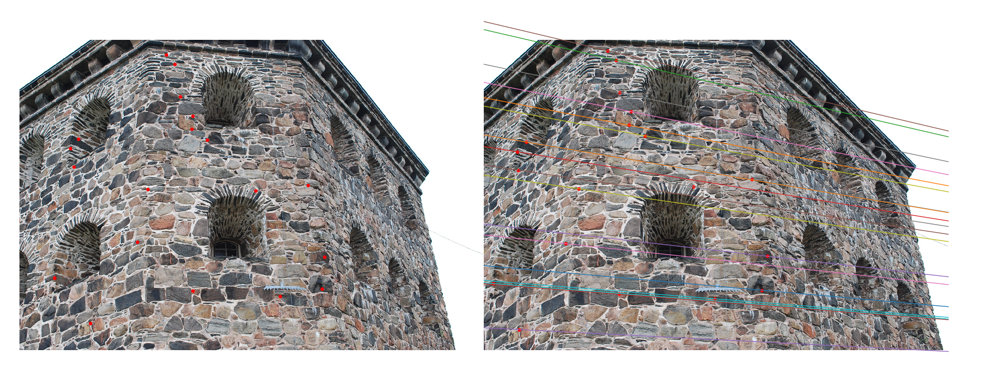

In [4]:
def computeFundamental(Pt1, Pt2, RankFix = True):
    U, Up = Pt1[:, 0, None], Pt2[:, 0, None]
    V, Vp = Pt1[:, 1, None], Pt2[:, 1, None]
    O = np.ones((Pt1.shape[0], 1))
    
    P1 = np.concatenate((Up, Up, Up, Vp, Vp, Vp, O, O, O), axis=1)
    P2 = np.concatenate((U, V, O, U, V, O, U, V, O), axis=1)
    
    Eqs = P1 * P2
    
    U, S, V = np.linalg.svd(Eqs)
    FR3 = V[-1, :].reshape((3, 3))

    F = None
    if RankFix:
        FU, FS, FV = np.linalg.svd(FR3)
        FS[-1] = 0.0
        F = np.dot(FU * FS, FV)
    else:
        F = FR3
    
    F /= F[2, 2]
    return F

Fund = computeFundamental(Im1Pts, Im2Pts)
Fund2 = computeFundamental(Im2Pts, Im1Pts)

PtsChoice = np.random.choice(np.arange(Im1Pts.shape[0]), 20)
Im1Chosen = Im1Pts[PtsChoice]
Im2Chosen = Im2Pts[PtsChoice]

print "x'^T @ F @ x = ", Im1Chosen[0].T.dot(Fund).dot(Im2Chosen[0])

fig, ax = DrawPoints(Im1, Im2, Im1Chosen, Im2Chosen)
def DrawEpipolars(PointPlot, Fund, Pts, Offset, Width):
    Lines = np.dot(Fund, Pts.T)
    for i in range(Pts.shape[0]):
        A, B, C = Lines[:, i]
        Xs = [Offset, Offset + Width]
        Ys = [C / -B, (Width * A + C) / -B]
        PointPlot.plot(Xs, Ys)
        
DrawEpipolars(ax, Fund, Im1Chosen, Im1.shape[1], Im2.shape[1])

x^T @ F2 @ x' =  0.008459609994357464


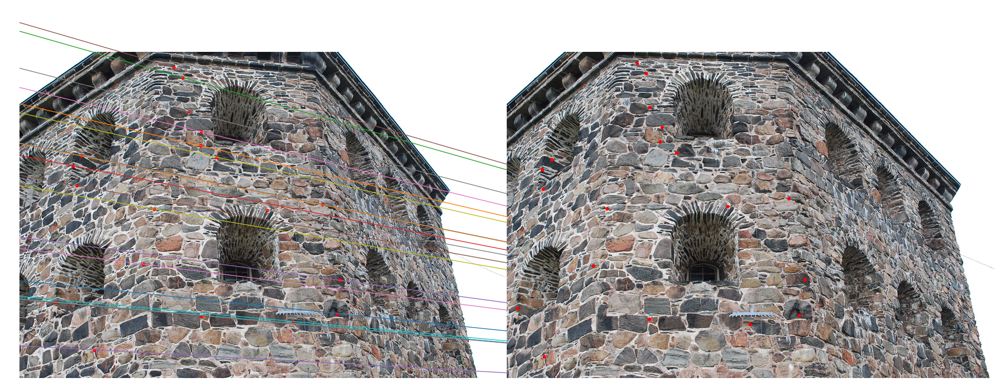

In [5]:
print "x^T @ F2 @ x' = ", Im2Chosen[0].T.dot(Fund).dot(Im1Chosen[0])
fig2, ax2 = DrawPoints(Im1, Im2, Im1Chosen, Im2Chosen)
DrawEpipolars(ax2, Fund2, Im2Chosen, 0, Im1.shape[1])

x'^T @ F @ x =  -16.01013907687104
x^T @ F2 @ x' =  -16.010139076873827


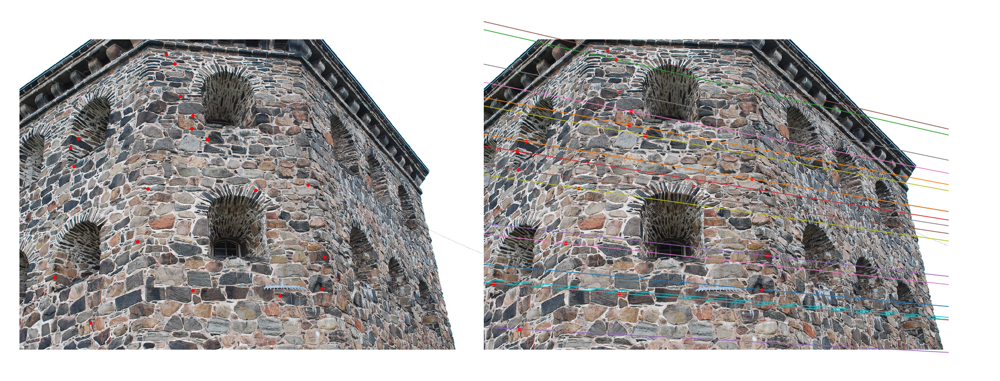

In [6]:
def normalizationTransform(Pts):
    Transform = np.identity(3)
    Mean = np.mean(Pts, axis=0)
    StdDev = np.std(Pts - Mean, axis=0)
    TargetStdDev = np.sqrt(2)
    
    SX = TargetStdDev / StdDev[0]
    SY = TargetStdDev / StdDev[1]
    TX = -Mean[0] * SX
    TY = -Mean[1] * SY
    
    Transform[[0, 1], [2, 2]] = TX, TY
    Transform[[0, 1], [0, 1]] = SX, SY
    
    return Transform
    
def normalize(Pts, Transform):
    return np.dot(Transform, Pts.T).T

T1 = normalizationTransform(Im1Pts)
T2 = normalizationTransform(Im2Pts)

Im1PtsNorm = normalize(Im1Pts, T1)
Im2PtsNorm = normalize(Im2Pts, T2)

FundNormalized = computeFundamental(Im1PtsNorm, Im2PtsNorm)
Fund2Normalized = computeFundamental(Im2PtsNorm, Im1PtsNorm)
FundDenormalized = T2.T.dot(FundNormalized).dot(T1)
Fund2Denormalized = T1.T.dot(Fund2Normalized).dot(T2)

print "x'^T @ F @ x = ", Im1Chosen[0].T.dot(FundDenormalized).dot(Im2Chosen[0])
print "x^T @ F2 @ x' = ", Im2Chosen[0].T.dot(Fund2Denormalized).dot(Im1Chosen[0])
fig3, ax3 = DrawPoints(Im1, Im2, Im1Chosen, Im2Chosen)
DrawEpipolars(ax3, FundDenormalized, Im1Chosen, Im1.shape[1], Im2.shape[1])


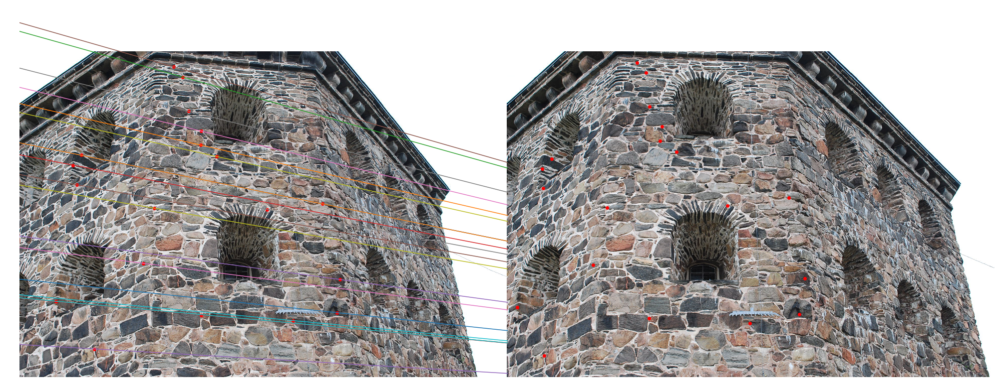

In [7]:
fig4, ax4 = DrawPoints(Im1, Im2, Im1Chosen, Im2Chosen)
DrawEpipolars(ax4, Fund2Denormalized, Im2Chosen, 0, Im1.shape[1])

x'^T @ F @ x =  30.18475319311642


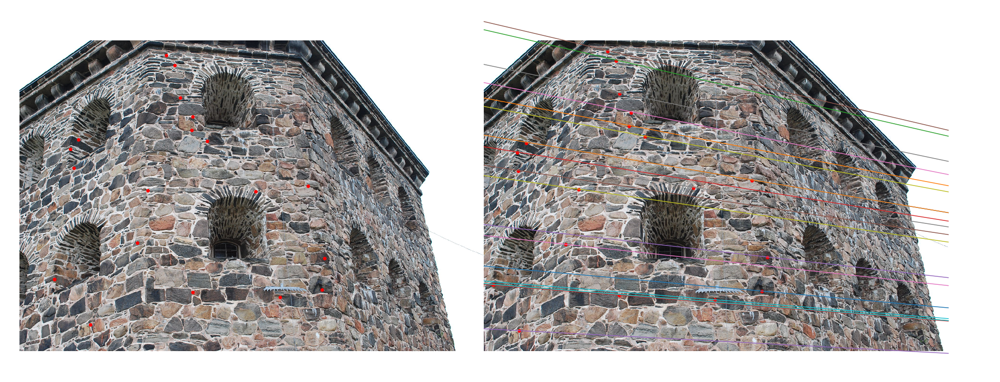

In [8]:
K = io.loadmat("data/compEx3data.mat")['K']
KInv = np.linalg.inv(K)
Im1PointsK = normalize(Im1Pts, KInv)
Im2PointsK = normalize(Im2Pts, KInv)

def computeEssential(Pt1, Pt2, RankFix = True):
    U, Up = Pt1[:, 0, None], Pt2[:, 0, None]
    V, Vp = Pt1[:, 1, None], Pt2[:, 1, None]
    O = np.ones((Pt1.shape[0], 1))
    
    P1 = np.concatenate((Up, Up, Up, Vp, Vp, Vp, O, O, O), axis=1)
    P2 = np.concatenate((U, V, O, U, V, O, U, V, O), axis=1)
    
    Eqs = P1 * P2
    
    U, S, V = np.linalg.svd(Eqs)
    ER3 = V[-1, :].reshape((3, 3))

    E = None
    if RankFix:
        EU, ES, EV = np.linalg.svd(ER3)
        ES = np.array([((ES[0] + ES[1]) / 2), ((ES[0] + ES[1]) / 2), 0.0])
        E = np.dot(EU * ES, EV)
    else:
        E = ER3
    
    E /= E[2, 2]
    return E

Essential = computeEssential(Im1PointsK, Im2PointsK)
Essential2 = computeEssential(Im2PointsK, Im1PointsK)

FundFromE = KInv.T.dot(Essential).dot(KInv)
Fund2FromE = KInv.T.dot(Essential2).dot(KInv)

print "x'^T @ F @ x = ", Im1Chosen[0].T.dot(FundFromE).dot(Im2Chosen[0])
fig5, ax5 = DrawPoints(Im1, Im2, Im1Chosen, Im2Chosen)
DrawEpipolars(ax5, FundFromE, Im1Chosen, Im1.shape[1], Im2.shape[1])

x'^T @ F2 @ x =  30.184753193204983


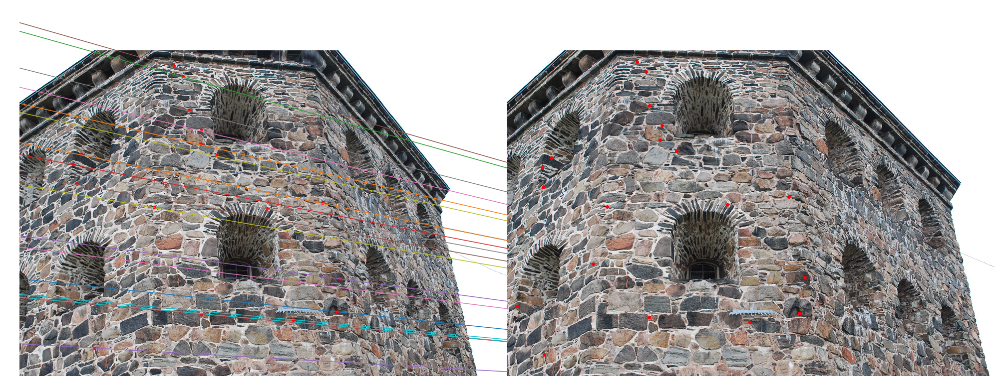

In [9]:
print "x'^T @ F2 @ x = ", Im2Chosen[0].T.dot(Fund2FromE).dot(Im1Chosen[0])
fig6, ax6 = DrawPoints(Im1, Im2, Im1Chosen, Im2Chosen)
DrawEpipolars(ax6, Fund2FromE, Im2Chosen, 0, Im1.shape[1])

In [10]:
EU, ES, EV = np.linalg.svd(Essential)

P1 = np.hstack((np.identity(3), np.array([[0, 0, 0]]).T))

W = np.array([
    [0.0, -1.0, 0.0],
    [1.0,  0.0, 0.0],
    [0.0,  0.0, 1.0]
])

u3 = EU[:, 2]

P2Candidates = [
    np.hstack((EU.dot(W).dot(EV), u3[:, None])),
    np.hstack((EU.dot(W).dot(EV), -u3[:, None])),
    np.hstack((EU.dot(W.T).dot(EV), u3[:, None])),
    np.hstack((EU.dot(W.T).dot(EV), -u3[:, None]))
]

def triangulate(P1, P2, Pt1, Pt2):
    Pt1 /= Pt1[2, None]
    Pt2 /= Pt2[2, None]
    
    Col1 = Pt1[0] * P1[2, :] - P1[0, :]
    Col2 = Pt1[1] * P1[2, :] - P1[1, :]
    Col3 = Pt2[0] * P2[2, :] - P2[0, :]
    Col4 = Pt2[1] * P2[2, :] - P2[1, :]
    
    A = np.vstack((Col1, Col2, Col3, Col4))
    
    U, S, V = np.linalg.svd(A)
    Res = V[-1, :]
    return Res

P2 = None

hits = [0, 0, 0, 0]

for P2Ind, P2C in enumerate(P2Candidates):
    Choice = np.random.choice(np.arange(Im1PointsK.shape[0]), 10)
    for Ind in Choice:
        X = triangulate(P1, P2C, Im1PointsK[Ind], Im2PointsK[Ind])
        X /= X[-1, None]

        p1 = np.dot(P1, X)
        p2 = np.dot(P2C, X)

        if p1[2] > 0 and p2[2] > 0:
            hits[P2Ind] += 1
            
best = 0
for i, hit in enumerate(hits):
    if hit > hits[best]:
        best = i

P2 = P2Candidates[best]
    
print "Found valid P2 projection:\n", P2, best

all_points = [triangulate(P1, P2, p1, p2) for (p1, p2) in zip(Im1PointsK, Im2PointsK)]
all_points = np.array(all_points)
all_points /= all_points[:, 3, None]

Found valid P2 projection:
[[-0.62208686 -0.27002211 -0.73491224  0.92229092]
 [-0.28035671  0.95323078 -0.11292118  0.14220198]
 [-0.73103218 -0.13579079  0.66869485  0.35938565]] 0


In [11]:
from plyfile import PlyData, PlyElement
XX = all_points / all_points[:, 2, None]
points = np.array(zip(XX[:,0].ravel(), XX[:,1].ravel(), XX[:,2].ravel()),dtype=[('x','f4'), ('y', 'f4'),('z', 'f4')])
el = PlyElement.describe(points, 'vertex')
PlyData([el]).write('pc.ply') 

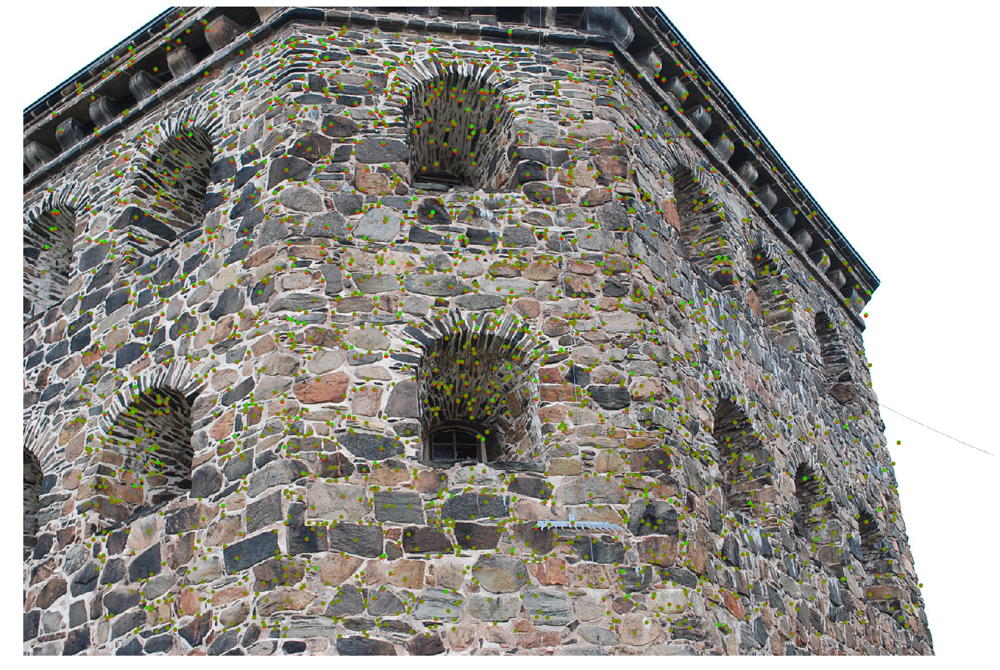

In [12]:
P1F = np.dot(K, P1)
P2F = np.dot(K, P2)

Im1Reproj = np.dot(P1F, all_points.T).T
Im2Reproj = np.dot(P2F, all_points.T).T
Im1Reproj /= Im1Reproj[:, 2, None]
Im2Reproj /= Im2Reproj[:, 2, None]

reprojim1 = figure(figsize=(35, 20))
ax_im1 = reprojim1.add_subplot(1, 1, 1)
ax_im1.axis('off')
ax_im1.imshow(Im1)
ax_im1.scatter(Im1Reproj[:, 0], Im1Reproj[:, 1], c=(1.0, 0.0, 0.0, 1.0))
ax_im1.scatter(Im1Pts[:, 0], Im1Pts[:, 1], c=(0.0, 1.0, 0.0, 0.5))

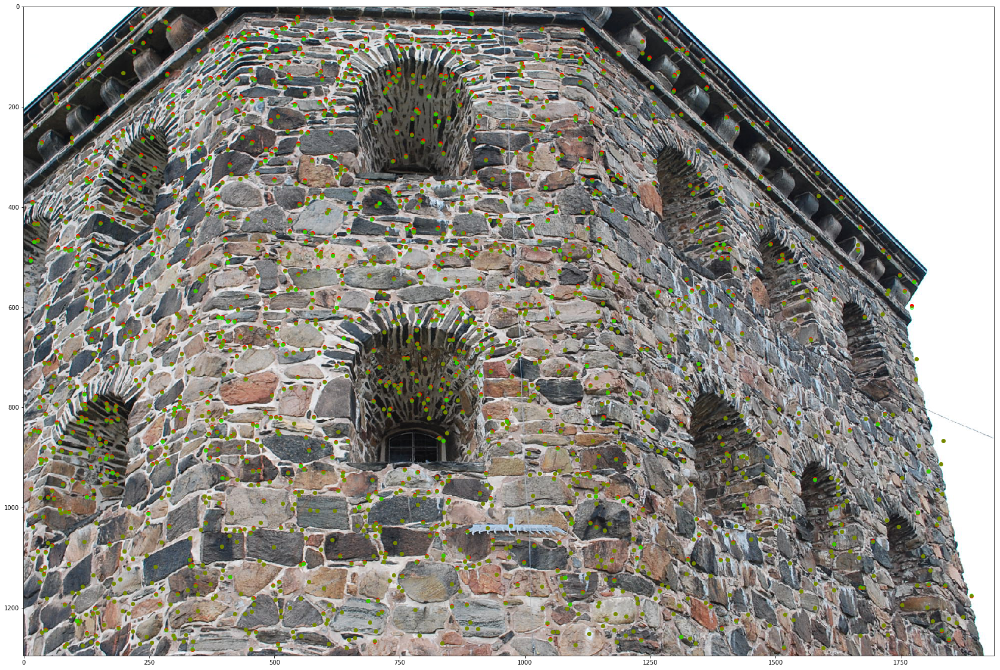

In [13]:
reprojim2 = figure(figsize=(35, 20))
ax_im2 = reprojim2.add_subplot(1, 1, 1)
ax_im2.imshow(Im2)
ax_im2.scatter(Im2Reproj[:, 0], Im2Reproj[:, 1], c=(1.0, 0.0, 0.0, 1.0))
ax_im2.scatter(Im2Pts[:, 0], Im2Pts[:, 1], c=(0.0, 1.0, 0.0, 0.5))

In [14]:
def reprojectionError(realPts, projectedPts):
    return np.sum(np.sqrt((realPts - projectedPts) ** 2))

print "Reprojection error for Im1 = ", reprojectionError(Im1Pts, Im1Reproj)
print "Reprojection error for Im2 = ", reprojectionError(Im2Pts, Im2Reproj)

Reprojection error for Im1 =  2339.3513676803905
Reprojection error for Im2 =  2407.7296926146546


In [15]:
r = Im1Pts[np.round(Im1Reproj[:, :3]).astype(np.uint), 0]
g = Im1Pts[np.round(Im1Reproj[:, :3]).astype(np.uint), 1]
b = Im1Pts[np.round(Im1Reproj[:, :3]).astype(np.uint), 2]
points = np.array(zip(XX[:,0].ravel(), XX[:,1].ravel(), XX[:,2].ravel(), r.ravel(), g.ravel(), b.ravel()),dtype=[('x','f4'), ('y', 'f4'),('z', 'f4'), ('red', 'u1'), ('green', 'u1'),('blue', 'u1')])
el = PlyElement.describe(points, 'vertex')
PlyData([el]).write('pccolored.ply') 
